![Архітектура](NN_diagram.drawio.png)

In [1]:
%load_ext autoreload
%autoreload 2

In [ ]:
from pathlib import Path
from PIL import Image
from itertools import product

from matplotlib import pyplot as plt
import torch
from torch.optim import RAdam
from torch.nn import CrossEntropyLoss
from torch.utils.data import DataLoader, random_split
from torch.optim.lr_scheduler import ReduceLROnPlateau
from torchinfo import summary
from torchvision import datasets
from torchvision.models import efficientnet_b2, EfficientNet_B2_Weights
from torchmetrics import ConfusionMatrix
from torchmetrics.classification import MulticlassAccuracy
from mlxtend.plotting import plot_confusion_matrix

from config import device, set_seed, SEED
from config import TRAIN_DATA_PATH, VALID_DATA_PATH, TEST_DATA_PATH, FOLDERS_DATA_TYPE, FOLDERS_CLASS_TYPE
from config import BATCH_SIZE, NUM_WORKERS
from augmentation import AugmentationV1, AugmentationEfficientnet_b2
from tiny_vgg import TinyVGG_V1
from func import train, compute_mean_std
from deploy_func import predict, compute_precision, compute_recall, compute_f1

In [ ]:
set_seed(SEED)

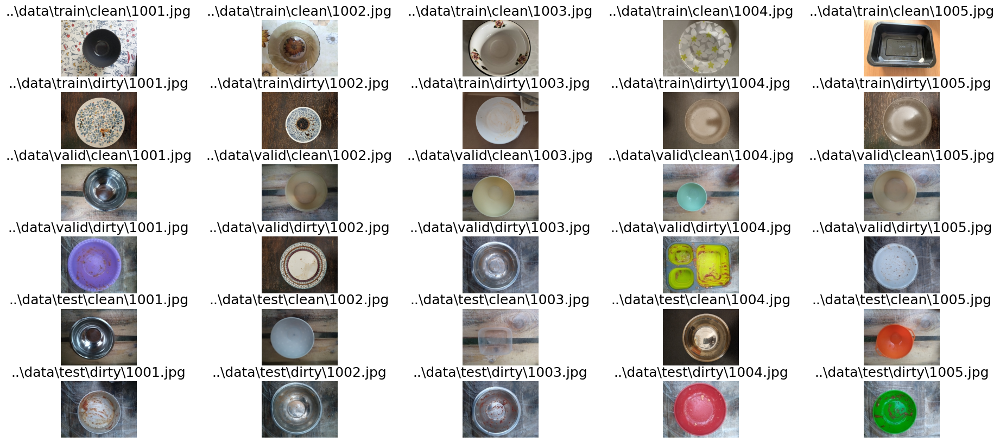

In [ ]:
ncols = 5

fig, axs = plt.subplots(nrows=len(FOLDERS_DATA_TYPE) * len(FOLDERS_CLASS_TYPE), 
                        ncols=ncols, 
                        figsize=(20, 8))

for multiply, data_type_path in enumerate(FOLDERS_DATA_TYPE):
    for row, class_type_path in enumerate(FOLDERS_CLASS_TYPE):
        folder = Path(data_type_path) / class_type_path
        for col, filename in enumerate(folder.iterdir()):
            if col >= ncols:
                break
            if filename.is_file():
                title = f'{filename}'
                current_row = multiply * len(FOLDERS_CLASS_TYPE) + row 
                axs[current_row, col].imshow(plt.imread(filename))
                axs[current_row, col].set_title(title, fontsize=18)
                axs[current_row, col].axis('off')

plt.tight_layout(pad=0.1)
plt.show()

In [ ]:
min_width = 100000
min_height = 100000
max_width = 0
max_height = 0

for data_type_path, class_type_path in product(FOLDERS_DATA_TYPE, FOLDERS_CLASS_TYPE):
    folder = Path(data_type_path) / class_type_path
    for filename in folder.iterdir():
        if filename.is_file():
            with Image.open(filename) as img:
                width = img.size[0]
                height = img.size[1]
                if width < min_width:
                    min_width = width
                if height < min_height:
                    min_height = height
                if width > max_width:
                    max_width = width
                if height > max_height:
                    max_height = height
print(f"Width: {min_width} - {max_width}")
print(f"Height: {min_height} - {max_height}")

Width: 192 - 351
Height: 255 - 341


# Розраховую mean та std для нормалізації

In [ ]:
compute_mean_std(TRAIN_DATA_PATH, (128, 128))

e:\Programming\PlatesClassification\.venv\Lib\site-packages\torchvision\transforms\v2\_deprecated.py:42: UserWarning: The transform `ToTensor()` is deprecated and will be removed in a future release. Instead, please use `v2.Compose([v2.ToImage(), v2.ToDtype(torch.float32, scale=True)])`.Output is equivalent up to float precision.
  warnings.warn(


([0.5194553136825562, 0.49972206354141235, 0.4698789119720459],
 [0.17592790722846985, 0.18309539556503296, 0.197753444314003])

# Роблю аугментації (augmentation.py)

In [ ]:
augmantation = AugmentationV1()

train_data = datasets.ImageFolder(
    root=TRAIN_DATA_PATH,
    transform=augmantation.get_train())

valid_data = datasets.ImageFolder(
    root=VALID_DATA_PATH,
    transform=augmantation.get_test())

test_data = datasets.ImageFolder(
    root=TEST_DATA_PATH,
    transform=augmantation.get_test())

print(f"Train data:\n{train_data}\nValid data:\n{valid_data}\nTest data:\n{test_data}")
CLASS_NAMES = train_data.classes
print(f"Class names: {CLASS_NAMES}")

Train data:
Dataset ImageFolder
    Number of datapoints: 458
    Root location: ../data/train
    StandardTransform
Transform: Compose(
                 Resize(size=[128, 128], interpolation=InterpolationMode.BILINEAR, antialias=True)
                 RandomHorizontalFlip(p=0.5)
                 RandomVerticalFlip(p=0.5)
                 RandomRotation(degrees=[-10.0, 10.0], interpolation=InterpolationMode.NEAREST, expand=False, fill=0)
                 ColorJitter(brightness=(0.9, 1.1), contrast=(0.9, 1.1), saturation=(0.9, 1.1), hue=(-0.05, 0.05))
                 TrivialAugmentWide(interpolation=InterpolationMode.NEAREST, num_magnitude_bins=31)
                 ToImage()
                 ToDtype(scale=True)
                 Normalize(mean=[0.519, 0.499, 0.469], std=[0.175, 0.183, 0.197], inplace=False)
           )
Valid data:
Dataset ImageFolder
    Number of datapoints: 501
    Root location: ../data/valid
    StandardTransform
Transform: Compose(
                 Resize(size=[12

# Створюю dataloaders (ділю на батчі)

In [ ]:
train_dataloader = DataLoader(
    dataset=train_data,
    batch_size=BATCH_SIZE,
    shuffle=True,
    num_workers=NUM_WORKERS,
    pin_memory=True,
    drop_last=True
)
valid_dataloader = DataLoader(
    dataset=valid_data,
    batch_size=BATCH_SIZE,
    shuffle=False,
    num_workers=NUM_WORKERS,
    pin_memory=True,
    drop_last=True
)

print(f'Length of train dataloader: {len(train_dataloader)}')
print(f'Length of valid dataloader: {len(valid_dataloader)}')

Length of train dataloader: 14
Length of valid dataloader: 15


# Виведені зображення різного кольору через std та mean в аугментації, можна денормалізувати, але не став

e:\Programming\PlatesClassification\.venv\Lib\site-packages\torch\utils\data\dataloader.py:665: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.6071708..2.7485714].


Train features batch shape: torch.Size([32, 3, 128, 128])
Train labels batch shape: torch.Size([32])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.9657142..2.3900285].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.8312604..2.7485714].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.9657142..2.5162737].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.9657142..2.3371158].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.9657142..2.7485714].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.9657142..2.3452106].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.965714

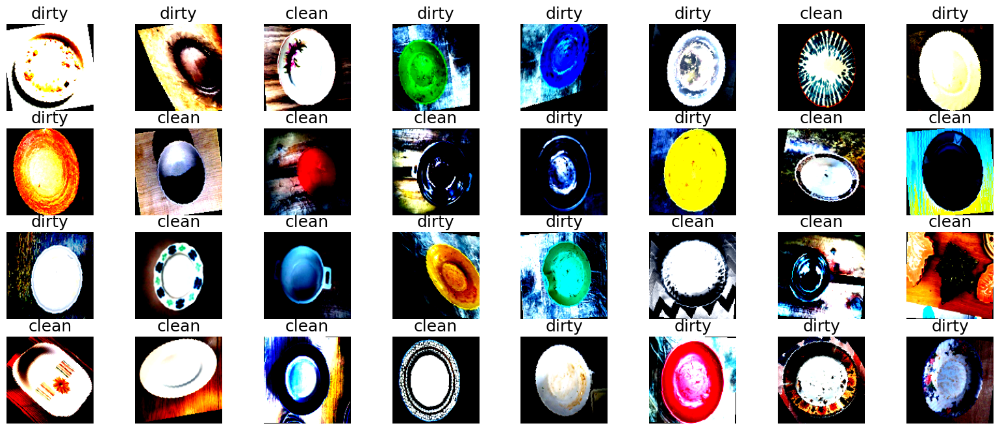

In [ ]:
train_features_batch, train_labels_batch = next(iter(train_dataloader))
print(f"Train features batch shape: {train_features_batch.shape}")
print(f"Train labels batch shape: {train_labels_batch.shape}")

ncols = 8
fig, axs = plt.subplots(nrows=int(BATCH_SIZE/ncols), ncols=ncols, figsize=(20, 8))
for batch in range(BATCH_SIZE):
    axs[batch // ncols, batch % ncols].imshow(train_features_batch[batch].permute(1, 2, 0))
    axs[batch // ncols, batch % ncols].set_title(f'{CLASS_NAMES[train_labels_batch[batch]]}', fontsize=18)
    axs[batch // ncols, batch % ncols].axis('off')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.5847619..2.716276].


Valid features batch shape: torch.Size([32, 3, 128, 128])
Valid labels batch shape: torch.Size([32])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.6519887..1.1626357].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.6295798..1.7399226].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.3382633..1.9389871].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.4278991..2.0186129].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.8536694..1.8991742].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.539944..2.658936].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.450308..

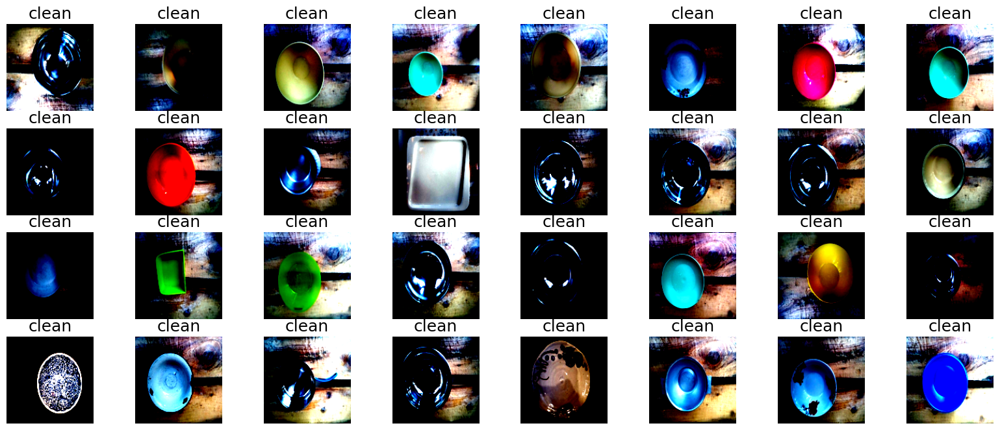

In [ ]:
valid_features_batch, valid_labels_batch = next(iter(valid_dataloader))
print(f"Valid features batch shape: {valid_features_batch.shape}")
print(f"Valid labels batch shape: {valid_labels_batch.shape}")

ncols = 8
fig, axs = plt.subplots(nrows=int(BATCH_SIZE/ncols), ncols=ncols, figsize=(20, 8))
for batch in range(BATCH_SIZE):
    axs[batch // ncols, batch % ncols].imshow(valid_features_batch[batch].permute(1, 2, 0))
    axs[batch // ncols, batch % ncols].set_title(f'{CLASS_NAMES[valid_labels_batch[batch]]}', fontsize=18)
    axs[batch // ncols, batch % ncols].axis('off')

# Створюю згорточну модель (tiny_vgg.py)

In [ ]:
epochs = 100

tinyVgg_v1 = TinyVGG_V1(input_channels=3, output_classes=len(CLASS_NAMES)).to(device)

loss_fn = CrossEntropyLoss().to(device)
accuracy_fn = MulticlassAccuracy(num_classes=len(CLASS_NAMES)).to(device)

optimizer = RAdam(
    params=tinyVgg_v1.parameters(),
    lr=0.001,
)
scheduler = ReduceLROnPlateau(
    optimizer=optimizer,
    factor=0.9,
    patience=0,
)

In [ ]:
summary(tinyVgg_v1)

Layer (type:depth-idx)                   Param #
TinyVGG_V1                               --
├─Sequential: 1-1                        --
│    └─Conv2d: 2-1                       448
│    └─BatchNorm2d: 2-2                  32
│    └─ReLU: 2-3                         --
│    └─Conv2d: 2-4                       2,320
│    └─BatchNorm2d: 2-5                  32
│    └─ReLU: 2-6                         --
│    └─MaxPool2d: 2-7                    --
│    └─Dropout: 2-8                      --
├─Sequential: 1-2                        --
│    └─Conv2d: 2-9                       4,640
│    └─BatchNorm2d: 2-10                 64
│    └─ReLU: 2-11                        --
│    └─Conv2d: 2-12                      9,248
│    └─BatchNorm2d: 2-13                 64
│    └─ReLU: 2-14                        --
│    └─MaxPool2d: 2-15                   --
│    └─Dropout: 2-16                     --
├─Sequential: 1-3                        --
│    └─Conv2d: 2-17                      18,496
│    └─BatchN

In [ ]:
train(
    train_dataloader=train_dataloader,
    valid_dataloader=valid_dataloader,
    model=tinyVgg_v1,
    loss_fn=loss_fn,
    accuracy_fn=accuracy_fn,
    optimizer=optimizer,
    epochs=epochs,
    scheduler=scheduler,
)

  1%|          | 1/100 [00:32<53:06, 32.19s/it]

Epoch: 1/100 |  Train loss: 0.7329 |  Train accuracy: 0.48 |  Valid loss: 0.6893 |  Valid accuracy: 0.62


  2%|▏         | 2/100 [01:04<52:28, 32.13s/it]

Epoch: 2/100 |  Train loss: 0.7228 |  Train accuracy: 0.51 |  Valid loss: 0.7093 |  Valid accuracy: 0.44


  3%|▎         | 3/100 [01:36<52:14, 32.31s/it]

Epoch: 3/100 |  Train loss: 0.7096 |  Train accuracy: 0.53 |  Valid loss: 0.7185 |  Valid accuracy: 0.51


  4%|▍         | 4/100 [02:07<50:54, 31.82s/it]

Epoch: 4/100 |  Train loss: 0.7148 |  Train accuracy: 0.51 |  Valid loss: 0.7387 |  Valid accuracy: 0.31


  5%|▌         | 5/100 [02:39<50:25, 31.85s/it]

Epoch: 5/100 |  Train loss: 0.7028 |  Train accuracy: 0.55 |  Valid loss: 0.6859 |  Valid accuracy: 0.55


  6%|▌         | 6/100 [03:11<49:48, 31.79s/it]

Epoch: 6/100 |  Train loss: 0.6828 |  Train accuracy: 0.53 |  Valid loss: 0.6988 |  Valid accuracy: 0.51


  7%|▋         | 7/100 [03:45<50:21, 32.48s/it]

Epoch: 7/100 |  Train loss: 0.6933 |  Train accuracy: 0.58 |  Valid loss: 0.6633 |  Valid accuracy: 0.52


  8%|▊         | 8/100 [04:15<48:50, 31.86s/it]

Epoch: 8/100 |  Train loss: 0.6782 |  Train accuracy: 0.60 |  Valid loss: 0.6755 |  Valid accuracy: 0.55


  9%|▉         | 9/100 [04:46<47:33, 31.36s/it]

Epoch: 9/100 |  Train loss: 0.6918 |  Train accuracy: 0.57 |  Valid loss: 0.6674 |  Valid accuracy: 0.55


 10%|█         | 10/100 [05:16<46:43, 31.15s/it]

Epoch: 10/100 |  Train loss: 0.6781 |  Train accuracy: 0.58 |  Valid loss: 0.6277 |  Valid accuracy: 0.56


 11%|█         | 11/100 [05:47<45:56, 30.98s/it]

Epoch: 11/100 |  Train loss: 0.6667 |  Train accuracy: 0.61 |  Valid loss: 0.6212 |  Valid accuracy: 0.55


 12%|█▏        | 12/100 [06:18<45:41, 31.16s/it]

Epoch: 12/100 |  Train loss: 0.6760 |  Train accuracy: 0.59 |  Valid loss: 0.6183 |  Valid accuracy: 0.52


 13%|█▎        | 13/100 [06:49<45:03, 31.08s/it]

Epoch: 13/100 |  Train loss: 0.6667 |  Train accuracy: 0.61 |  Valid loss: 0.5872 |  Valid accuracy: 0.56


 14%|█▍        | 14/100 [07:20<44:11, 30.83s/it]

Epoch: 14/100 |  Train loss: 0.6585 |  Train accuracy: 0.60 |  Valid loss: 0.6022 |  Valid accuracy: 0.56


 15%|█▌        | 15/100 [07:50<43:32, 30.73s/it]

Epoch: 15/100 |  Train loss: 0.6457 |  Train accuracy: 0.65 |  Valid loss: 0.5846 |  Valid accuracy: 0.56


 16%|█▌        | 16/100 [08:20<42:46, 30.55s/it]

Epoch: 16/100 |  Train loss: 0.6473 |  Train accuracy: 0.63 |  Valid loss: 0.5493 |  Valid accuracy: 0.56


 17%|█▋        | 17/100 [08:51<42:24, 30.66s/it]

Epoch: 17/100 |  Train loss: 0.6487 |  Train accuracy: 0.61 |  Valid loss: 0.5160 |  Valid accuracy: 0.56


 18%|█▊        | 18/100 [09:21<41:38, 30.47s/it]

Epoch: 18/100 |  Train loss: 0.6359 |  Train accuracy: 0.63 |  Valid loss: 0.4848 |  Valid accuracy: 0.60


 19%|█▉        | 19/100 [09:51<40:57, 30.33s/it]

Epoch: 19/100 |  Train loss: 0.6486 |  Train accuracy: 0.64 |  Valid loss: 0.4639 |  Valid accuracy: 0.56


 20%|██        | 20/100 [10:22<40:27, 30.35s/it]

Epoch: 20/100 |  Train loss: 0.6287 |  Train accuracy: 0.65 |  Valid loss: 0.4323 |  Valid accuracy: 0.60


 21%|██        | 21/100 [10:52<39:52, 30.29s/it]

Epoch: 21/100 |  Train loss: 0.6040 |  Train accuracy: 0.68 |  Valid loss: 0.4500 |  Valid accuracy: 0.60


 22%|██▏       | 22/100 [11:22<39:19, 30.25s/it]

Epoch: 22/100 |  Train loss: 0.6478 |  Train accuracy: 0.62 |  Valid loss: 0.4588 |  Valid accuracy: 0.56


 23%|██▎       | 23/100 [11:53<39:06, 30.47s/it]

Epoch: 23/100 |  Train loss: 0.6213 |  Train accuracy: 0.65 |  Valid loss: 0.4493 |  Valid accuracy: 0.56


 24%|██▍       | 24/100 [12:23<38:22, 30.30s/it]

Epoch: 24/100 |  Train loss: 0.6217 |  Train accuracy: 0.64 |  Valid loss: 0.4338 |  Valid accuracy: 0.60


 25%|██▌       | 25/100 [12:53<37:56, 30.36s/it]

Epoch: 25/100 |  Train loss: 0.6239 |  Train accuracy: 0.66 |  Valid loss: 0.4135 |  Valid accuracy: 0.56


 26%|██▌       | 26/100 [13:23<37:18, 30.25s/it]

Epoch: 26/100 |  Train loss: 0.6240 |  Train accuracy: 0.65 |  Valid loss: 0.4221 |  Valid accuracy: 0.56


 27%|██▋       | 27/100 [13:54<37:05, 30.49s/it]

Epoch: 27/100 |  Train loss: 0.6151 |  Train accuracy: 0.68 |  Valid loss: 0.4355 |  Valid accuracy: 0.56


 28%|██▊       | 28/100 [14:25<36:42, 30.59s/it]

Epoch: 28/100 |  Train loss: 0.6031 |  Train accuracy: 0.69 |  Valid loss: 0.4534 |  Valid accuracy: 0.56


 29%|██▉       | 29/100 [14:56<36:07, 30.53s/it]

Epoch: 29/100 |  Train loss: 0.6197 |  Train accuracy: 0.64 |  Valid loss: 0.4211 |  Valid accuracy: 0.56


 30%|███       | 30/100 [15:25<35:21, 30.31s/it]

Epoch: 30/100 |  Train loss: 0.5934 |  Train accuracy: 0.68 |  Valid loss: 0.3852 |  Valid accuracy: 0.56


 31%|███       | 31/100 [16:00<36:27, 31.70s/it]

Epoch: 31/100 |  Train loss: 0.5765 |  Train accuracy: 0.69 |  Valid loss: 0.3697 |  Valid accuracy: 0.56


 32%|███▏      | 32/100 [16:33<36:19, 32.05s/it]

Epoch: 32/100 |  Train loss: 0.5856 |  Train accuracy: 0.70 |  Valid loss: 0.3843 |  Valid accuracy: 0.56


 33%|███▎      | 33/100 [17:06<36:07, 32.35s/it]

Epoch: 33/100 |  Train loss: 0.5751 |  Train accuracy: 0.73 |  Valid loss: 0.3792 |  Valid accuracy: 0.56


 34%|███▍      | 34/100 [17:38<35:33, 32.32s/it]

Epoch: 34/100 |  Train loss: 0.5912 |  Train accuracy: 0.67 |  Valid loss: 0.3799 |  Valid accuracy: 0.56


 35%|███▌      | 35/100 [18:11<35:08, 32.43s/it]

Epoch: 35/100 |  Train loss: 0.5735 |  Train accuracy: 0.72 |  Valid loss: 0.3969 |  Valid accuracy: 0.56


 36%|███▌      | 36/100 [18:45<34:55, 32.73s/it]

Epoch: 36/100 |  Train loss: 0.5808 |  Train accuracy: 0.70 |  Valid loss: 0.3853 |  Valid accuracy: 0.56


 37%|███▋      | 37/100 [19:16<33:58, 32.35s/it]

Epoch: 37/100 |  Train loss: 0.6061 |  Train accuracy: 0.68 |  Valid loss: 0.3906 |  Valid accuracy: 0.56


 38%|███▊      | 38/100 [19:48<33:11, 32.13s/it]

Epoch: 38/100 |  Train loss: 0.5872 |  Train accuracy: 0.70 |  Valid loss: 0.3890 |  Valid accuracy: 0.56


 39%|███▉      | 39/100 [20:20<32:38, 32.10s/it]

Epoch: 39/100 |  Train loss: 0.5651 |  Train accuracy: 0.70 |  Valid loss: 0.4163 |  Valid accuracy: 0.56


 40%|████      | 40/100 [20:52<32:01, 32.02s/it]

Epoch: 40/100 |  Train loss: 0.5788 |  Train accuracy: 0.71 |  Valid loss: 0.4095 |  Valid accuracy: 0.56


 41%|████      | 41/100 [21:24<31:38, 32.18s/it]

Epoch: 41/100 |  Train loss: 0.5857 |  Train accuracy: 0.68 |  Valid loss: 0.3992 |  Valid accuracy: 0.56


 42%|████▏     | 42/100 [21:56<30:59, 32.06s/it]

Epoch: 42/100 |  Train loss: 0.5749 |  Train accuracy: 0.70 |  Valid loss: 0.3705 |  Valid accuracy: 0.56


 43%|████▎     | 43/100 [22:27<30:19, 31.93s/it]

Epoch: 43/100 |  Train loss: 0.5438 |  Train accuracy: 0.73 |  Valid loss: 0.3703 |  Valid accuracy: 0.56


 44%|████▍     | 44/100 [23:00<30:05, 32.24s/it]

Epoch: 44/100 |  Train loss: 0.5593 |  Train accuracy: 0.73 |  Valid loss: 0.3770 |  Valid accuracy: 0.56


 45%|████▌     | 45/100 [23:33<29:45, 32.46s/it]

Epoch: 45/100 |  Train loss: 0.5575 |  Train accuracy: 0.71 |  Valid loss: 0.3728 |  Valid accuracy: 0.56


 46%|████▌     | 46/100 [24:05<29:06, 32.33s/it]

Epoch: 46/100 |  Train loss: 0.5734 |  Train accuracy: 0.67 |  Valid loss: 0.3763 |  Valid accuracy: 0.56


 47%|████▋     | 47/100 [24:38<28:33, 32.33s/it]

Epoch: 47/100 |  Train loss: 0.5768 |  Train accuracy: 0.69 |  Valid loss: 0.3878 |  Valid accuracy: 0.56


 48%|████▊     | 48/100 [25:09<27:48, 32.09s/it]

Epoch: 48/100 |  Train loss: 0.5674 |  Train accuracy: 0.71 |  Valid loss: 0.3897 |  Valid accuracy: 0.59


 49%|████▉     | 49/100 [25:41<27:13, 32.03s/it]

Epoch: 49/100 |  Train loss: 0.5985 |  Train accuracy: 0.69 |  Valid loss: 0.3773 |  Valid accuracy: 0.56


 50%|█████     | 50/100 [26:13<26:33, 31.86s/it]

Epoch: 50/100 |  Train loss: 0.5787 |  Train accuracy: 0.72 |  Valid loss: 0.3723 |  Valid accuracy: 0.56


 51%|█████     | 51/100 [26:45<26:01, 31.87s/it]

Epoch: 51/100 |  Train loss: 0.5876 |  Train accuracy: 0.69 |  Valid loss: 0.3674 |  Valid accuracy: 0.56


 52%|█████▏    | 52/100 [27:16<25:23, 31.73s/it]

Epoch: 52/100 |  Train loss: 0.5881 |  Train accuracy: 0.69 |  Valid loss: 0.3596 |  Valid accuracy: 0.56


 53%|█████▎    | 53/100 [27:47<24:37, 31.43s/it]

Epoch: 53/100 |  Train loss: 0.6035 |  Train accuracy: 0.69 |  Valid loss: 0.3687 |  Valid accuracy: 0.56


 54%|█████▍    | 54/100 [28:17<23:56, 31.22s/it]

Epoch: 54/100 |  Train loss: 0.5703 |  Train accuracy: 0.71 |  Valid loss: 0.3815 |  Valid accuracy: 0.56


 55%|█████▌    | 55/100 [28:50<23:44, 31.65s/it]

Epoch: 55/100 |  Train loss: 0.6031 |  Train accuracy: 0.69 |  Valid loss: 0.3825 |  Valid accuracy: 0.56


 56%|█████▌    | 56/100 [29:22<23:20, 31.82s/it]

Epoch: 56/100 |  Train loss: 0.5838 |  Train accuracy: 0.72 |  Valid loss: 0.3774 |  Valid accuracy: 0.56


 57%|█████▋    | 57/100 [29:55<23:04, 32.20s/it]

Epoch: 57/100 |  Train loss: 0.5680 |  Train accuracy: 0.70 |  Valid loss: 0.3742 |  Valid accuracy: 0.56


 58%|█████▊    | 58/100 [30:29<22:51, 32.66s/it]

Epoch: 58/100 |  Train loss: 0.5675 |  Train accuracy: 0.69 |  Valid loss: 0.3757 |  Valid accuracy: 0.56


 59%|█████▉    | 59/100 [31:03<22:39, 33.17s/it]

Epoch: 59/100 |  Train loss: 0.5721 |  Train accuracy: 0.70 |  Valid loss: 0.3647 |  Valid accuracy: 0.56


 60%|██████    | 60/100 [31:37<22:08, 33.21s/it]

Epoch: 60/100 |  Train loss: 0.5898 |  Train accuracy: 0.66 |  Valid loss: 0.3657 |  Valid accuracy: 0.56


 61%|██████    | 61/100 [32:11<21:50, 33.60s/it]

Epoch: 61/100 |  Train loss: 0.6009 |  Train accuracy: 0.68 |  Valid loss: 0.3769 |  Valid accuracy: 0.56


 62%|██████▏   | 62/100 [32:47<21:38, 34.17s/it]

Epoch: 62/100 |  Train loss: 0.5783 |  Train accuracy: 0.70 |  Valid loss: 0.3854 |  Valid accuracy: 0.56


 63%|██████▎   | 63/100 [33:24<21:42, 35.22s/it]

Epoch: 63/100 |  Train loss: 0.5965 |  Train accuracy: 0.67 |  Valid loss: 0.3843 |  Valid accuracy: 0.56


 64%|██████▍   | 64/100 [34:00<21:12, 35.34s/it]

Epoch: 64/100 |  Train loss: 0.5510 |  Train accuracy: 0.71 |  Valid loss: 0.3871 |  Valid accuracy: 0.59


 65%|██████▌   | 65/100 [34:33<20:14, 34.71s/it]

Epoch: 65/100 |  Train loss: 0.5655 |  Train accuracy: 0.72 |  Valid loss: 0.3836 |  Valid accuracy: 0.59


 66%|██████▌   | 66/100 [35:06<19:19, 34.12s/it]

Epoch: 66/100 |  Train loss: 0.5997 |  Train accuracy: 0.68 |  Valid loss: 0.3762 |  Valid accuracy: 0.56


 67%|██████▋   | 67/100 [35:38<18:26, 33.52s/it]

Epoch: 67/100 |  Train loss: 0.5667 |  Train accuracy: 0.72 |  Valid loss: 0.3661 |  Valid accuracy: 0.56


 68%|██████▊   | 68/100 [36:08<17:21, 32.54s/it]

Epoch: 68/100 |  Train loss: 0.5708 |  Train accuracy: 0.68 |  Valid loss: 0.3740 |  Valid accuracy: 0.56


 69%|██████▉   | 69/100 [36:38<16:25, 31.79s/it]

Epoch: 69/100 |  Train loss: 0.5786 |  Train accuracy: 0.71 |  Valid loss: 0.3831 |  Valid accuracy: 0.59


 70%|███████   | 70/100 [37:09<15:45, 31.53s/it]

Epoch: 70/100 |  Train loss: 0.5895 |  Train accuracy: 0.69 |  Valid loss: 0.3807 |  Valid accuracy: 0.59


 71%|███████   | 71/100 [37:40<15:02, 31.13s/it]

Epoch: 71/100 |  Train loss: 0.5640 |  Train accuracy: 0.71 |  Valid loss: 0.3820 |  Valid accuracy: 0.59


 72%|███████▏  | 72/100 [38:11<14:31, 31.14s/it]

Epoch: 72/100 |  Train loss: 0.5690 |  Train accuracy: 0.69 |  Valid loss: 0.3716 |  Valid accuracy: 0.56


 73%|███████▎  | 73/100 [38:43<14:10, 31.50s/it]

Epoch: 73/100 |  Train loss: 0.5516 |  Train accuracy: 0.72 |  Valid loss: 0.3843 |  Valid accuracy: 0.59


 74%|███████▍  | 74/100 [39:19<14:15, 32.90s/it]

Epoch: 74/100 |  Train loss: 0.6044 |  Train accuracy: 0.69 |  Valid loss: 0.3843 |  Valid accuracy: 0.59


 75%|███████▌  | 75/100 [39:54<13:54, 33.39s/it]

Epoch: 75/100 |  Train loss: 0.5540 |  Train accuracy: 0.73 |  Valid loss: 0.3839 |  Valid accuracy: 0.59


Test count: 219


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.9802322e-08..0.8117648].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.9802322e-08..0.96470594].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.9802322e-08..0.9215687].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.9802322e-08..0.9843137].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.9802322e-08..0.9764706].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.9802322e-08..0.9843138].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for intege

175/219 Accuracy: 79.91%
Precision:  0.8027716875076294
Recall:  0.798832356929779
f1:  0.7983763217926025


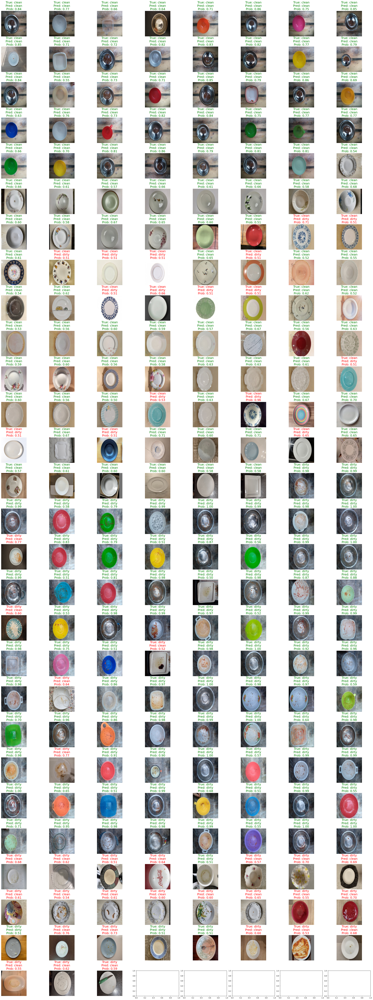

In [ ]:
print(f"Test count: {len(test_data)}")
true_values = []
pred_values = []

n_images = len(test_data)
ncols = 8
nrows = (n_images + ncols - 1) // ncols
fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(ncols * 4, nrows * 3))

mean = [0.519, 0.499, 0.469]
std = [0.175, 0.183, 0.197]
    
def denormalize(img, mean, std):
    img = img.clone()
    for t, m, s in zip(img, mean, std):
        t.mul_(s).add_(m)
    return img

for i in range(n_images):
    X = test_data[i][0]
    y = test_data[i][1]
    
    pred_label, pred_prob = predict(X, tinyVgg_v1)
    true_values.append(y)
    pred_values.append(pred_label)
    
    img_show = denormalize(X, mean, std)
    text = f'True: {CLASS_NAMES[y]}\nPred: {CLASS_NAMES[pred_label]}\nProb: {pred_prob:.2f}'
    color = 'green' if y == pred_label else 'red'
    axs[i // ncols, i % ncols].imshow(img_show.permute(1, 2, 0))
    axs[i // ncols, i % ncols].set_title(text, fontsize=18, color=color)
    axs[i // ncols, i % ncols].axis('off')
plt.tight_layout(pad=0.2)
    
compar_list = [a == b for a, b in zip(true_values, pred_values)]
true_sum = sum(compar_list)
count = len(compar_list)
accuracy = true_sum / count

print(f'{true_sum}/{count} Accuracy: {accuracy:.2%}')

print('Precision: ', compute_precision(true_values, pred_values, len(CLASS_NAMES)))
print('Recall: ', compute_recall(true_values, pred_values, len(CLASS_NAMES)))
print('f1: ', compute_f1(true_values, pred_values, len(CLASS_NAMES)))

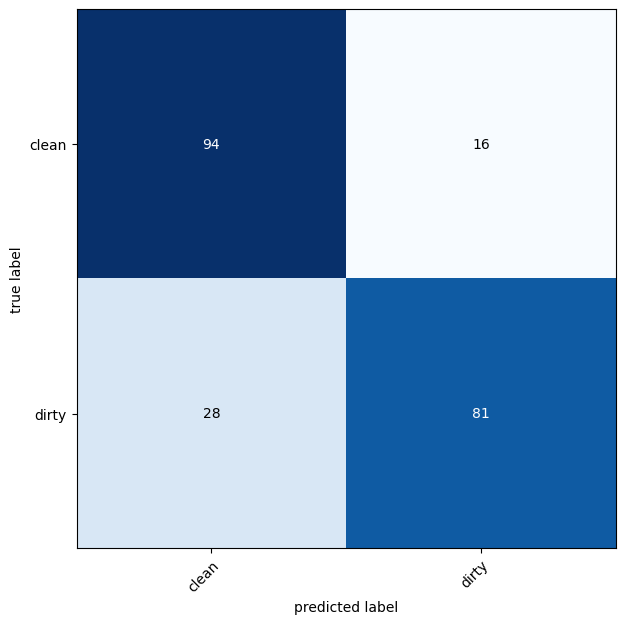

In [ ]:
confmat = ConfusionMatrix(num_classes=len(CLASS_NAMES), task='multiclass')
confmat_tensor = confmat(preds=torch.tensor(pred_values),
                         target=torch.tensor(true_values))

fig, ax = plot_confusion_matrix(
    conf_mat=confmat_tensor.numpy(), 
    class_names=CLASS_NAMES,
    figsize=(10, 7)
);

# Pretrained model

In [ ]:
augmantation = AugmentationEfficientnet_b2()

train_data = datasets.ImageFolder(
    root=TRAIN_DATA_PATH,
    transform=augmantation.get_train())

valid_data = datasets.ImageFolder(
    root=VALID_DATA_PATH,
    transform=augmantation.get_test())

test_data = datasets.ImageFolder(
    root=TEST_DATA_PATH,
    transform=augmantation.get_test())

print(f"Train data:\n{train_data}\nValid data:\n{valid_data}\nTest data:\n{test_data}")
CLASS_NAMES = train_data.classes
print(f"Class names: {CLASS_NAMES}")

Train data:
Dataset ImageFolder
    Number of datapoints: 458
    Root location: ../data/train
    StandardTransform
Transform: Compose(
                 Resize(size=[288, 288], interpolation=InterpolationMode.BILINEAR, antialias=True)
                 RandomHorizontalFlip(p=0.5)
                 RandomVerticalFlip(p=0.5)
                 RandomRotation(degrees=[-10.0, 10.0], interpolation=InterpolationMode.NEAREST, expand=False, fill=0)
                 ColorJitter(brightness=(0.9, 1.1), contrast=(0.9, 1.1), saturation=(0.9, 1.1), hue=(-0.05, 0.05))
                 TrivialAugmentWide(interpolation=InterpolationMode.NEAREST, num_magnitude_bins=31)
                 ToImage()
                 ToDtype(scale=True)
                 Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225], inplace=False)
           )
Valid data:
Dataset ImageFolder
    Number of datapoints: 501
    Root location: ../data/valid
    StandardTransform
Transform: Compose(
                 Resize(size=[28

In [ ]:
train_dataloader = DataLoader(
    dataset=train_data,
    batch_size=BATCH_SIZE,
    shuffle=True,
    num_workers=NUM_WORKERS,
    pin_memory=True,
    drop_last=True
)
valid_dataloader = DataLoader(
    dataset=valid_data,
    batch_size=BATCH_SIZE,
    shuffle=False,
    num_workers=NUM_WORKERS,
    pin_memory=True,
    drop_last=True
)

print(f'Length of train dataloader: {len(train_dataloader)}')
print(f'Length of valid dataloader: {len(valid_dataloader)}')

Length of train dataloader: 14
Length of valid dataloader: 15


In [ ]:
efficientnet_b2_model = efficientnet_b2(weights=EfficientNet_B2_Weights.DEFAULT).to(device)

In [ ]:
summary(model=efficientnet_b2_model, 
        input_size=(BATCH_SIZE, 3, 288, 288),
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"]
) 

Layer (type (var_name))                                      Input Shape          Output Shape         Param #              Trainable
EfficientNet (EfficientNet)                                  [32, 3, 288, 288]    [32, 1000]           --                   True
├─Sequential (features)                                      [32, 3, 288, 288]    [32, 1408, 9, 9]     --                   True
│    └─Conv2dNormActivation (0)                              [32, 3, 288, 288]    [32, 32, 144, 144]   --                   True
│    │    └─Conv2d (0)                                       [32, 3, 288, 288]    [32, 32, 144, 144]   864                  True
│    │    └─BatchNorm2d (1)                                  [32, 32, 144, 144]   [32, 32, 144, 144]   64                   True
│    │    └─SiLU (2)                                         [32, 32, 144, 144]   [32, 32, 144, 144]   --                   --
│    └─Sequential (1)                                        [32, 32, 144, 144]   [32, 16, 144

In [ ]:
for param in efficientnet_b2_model.parameters():
    param.requires_grad = False

In [ ]:
efficientnet_b2_model.classifier = torch.nn.Sequential(
        torch.nn.Dropout(p=0.5, inplace=False),
        torch.nn.Linear(in_features=1408,
                        out_features=256,
                        bias=True),
        torch.nn.ReLU(inplace=False),
        torch.nn.Dropout(0.5, inplace=False),
        torch.nn.Linear(in_features=256,
                        out_features=len(CLASS_NAMES),
                        bias=True)).to(device)

In [ ]:
summary(model=efficientnet_b2_model, 
        input_size=(BATCH_SIZE, 3, 288, 288),
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"]
) 

Layer (type (var_name))                                      Input Shape          Output Shape         Param #              Trainable
EfficientNet (EfficientNet)                                  [32, 3, 288, 288]    [32, 2]              --                   Partial
├─Sequential (features)                                      [32, 3, 288, 288]    [32, 1408, 9, 9]     --                   False
│    └─Conv2dNormActivation (0)                              [32, 3, 288, 288]    [32, 32, 144, 144]   --                   False
│    │    └─Conv2d (0)                                       [32, 3, 288, 288]    [32, 32, 144, 144]   (864)                False
│    │    └─BatchNorm2d (1)                                  [32, 32, 144, 144]   [32, 32, 144, 144]   (64)                 False
│    │    └─SiLU (2)                                         [32, 32, 144, 144]   [32, 32, 144, 144]   --                   --
│    └─Sequential (1)                                        [32, 32, 144, 144]   [32, 

In [ ]:
epochs = 10

loss_fn = CrossEntropyLoss().to(device)
accuracy_fn = MulticlassAccuracy(num_classes=len(CLASS_NAMES)).to(device)

optimizer = RAdam(
    params=efficientnet_b2_model.parameters(),
    lr=0.001,
)
scheduler = ReduceLROnPlateau(
    optimizer=optimizer,
    factor=0.9,
    patience=0,
)

  0%|          | 0/10 [00:00<?, ?it/s]e:\Programming\PlatesClassification\.venv\Lib\site-packages\torch\utils\data\dataloader.py:665: UserWarning: 'pin_memory' argument is set as true but no accelerator is found, then device pinned memory won't be used.
  warnings.warn(warn_msg)
 10%|█         | 1/10 [01:33<14:00, 93.42s/it]

Epoch: 1/10 |  Train loss: 0.6878 |  Train accuracy: 0.55 |  Valid loss: 0.6644 |  Valid accuracy: 0.51


 20%|██        | 2/10 [03:04<12:15, 91.93s/it]

Epoch: 2/10 |  Train loss: 0.6761 |  Train accuracy: 0.56 |  Valid loss: 0.6191 |  Valid accuracy: 0.62


 30%|███       | 3/10 [04:26<10:13, 87.67s/it]

Epoch: 3/10 |  Train loss: 0.6302 |  Train accuracy: 0.74 |  Valid loss: 0.5651 |  Valid accuracy: 0.62


 40%|████      | 4/10 [05:51<08:38, 86.37s/it]

Epoch: 4/10 |  Train loss: 0.5922 |  Train accuracy: 0.79 |  Valid loss: 0.4910 |  Valid accuracy: 0.72


 50%|█████     | 5/10 [07:13<07:04, 84.98s/it]

Epoch: 5/10 |  Train loss: 0.5376 |  Train accuracy: 0.83 |  Valid loss: 0.4143 |  Valid accuracy: 0.66


 60%|██████    | 6/10 [08:36<05:37, 84.28s/it]

Epoch: 6/10 |  Train loss: 0.4926 |  Train accuracy: 0.84 |  Valid loss: 0.3382 |  Valid accuracy: 0.72


 70%|███████   | 7/10 [10:00<04:11, 83.98s/it]

Epoch: 7/10 |  Train loss: 0.4492 |  Train accuracy: 0.84 |  Valid loss: 0.2751 |  Valid accuracy: 0.72


 80%|████████  | 8/10 [11:23<02:47, 83.82s/it]

Epoch: 8/10 |  Train loss: 0.3950 |  Train accuracy: 0.85 |  Valid loss: 0.2288 |  Valid accuracy: 0.69


 90%|█████████ | 9/10 [12:48<01:24, 84.07s/it]

Epoch: 9/10 |  Train loss: 0.3766 |  Train accuracy: 0.86 |  Valid loss: 0.1949 |  Valid accuracy: 0.66


100%|██████████| 10/10 [14:18<00:00, 85.86s/it]

Epoch: 10/10 |  Train loss: 0.3410 |  Train accuracy: 0.87 |  Valid loss: 0.1692 |  Valid accuracy: 0.76
Training time: 858.57 seconds


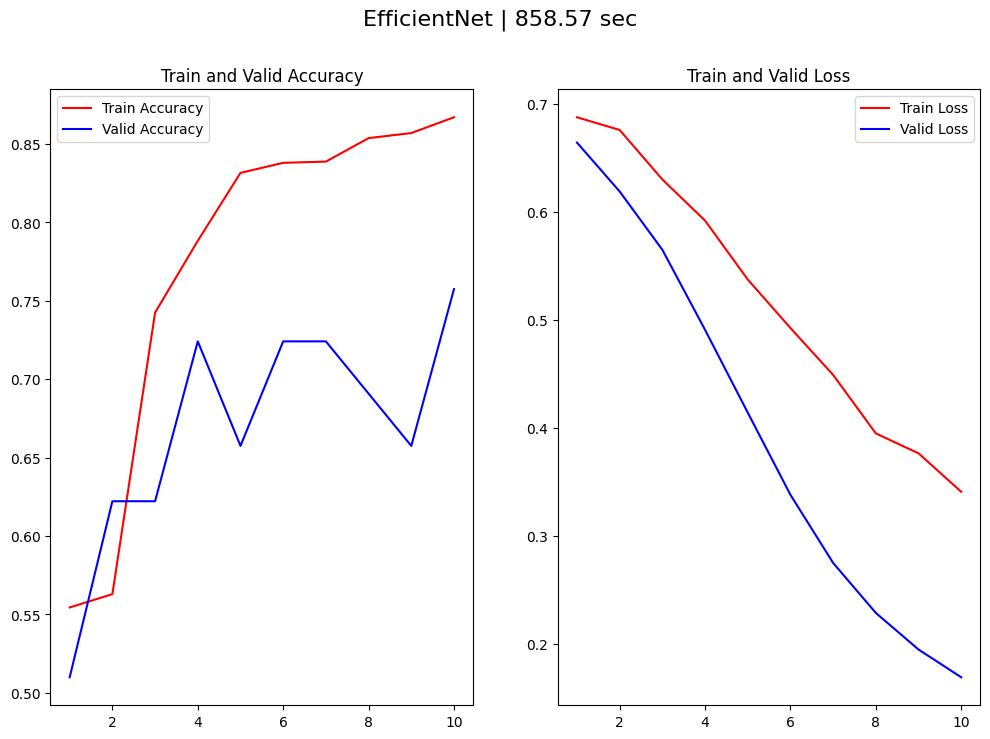

In [ ]:
train(
    train_dataloader=train_dataloader,
    valid_dataloader=valid_dataloader,
    model=efficientnet_b2_model,
    loss_fn=loss_fn,
    accuracy_fn=accuracy_fn,
    optimizer=optimizer,
    epochs=epochs,
    scheduler=scheduler,
)

Test count: 219


AttributeError: 'ImageFolder' object has no attribute 'dataset'

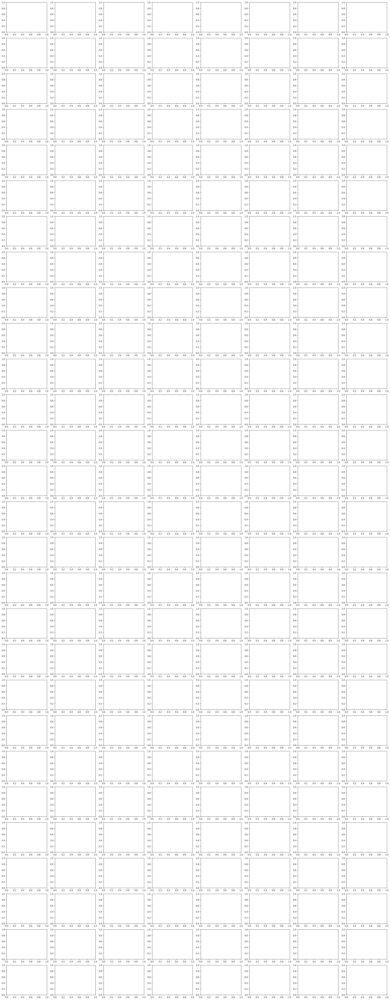

In [ ]:
print(f"Test count: {len(test_data)}")

true_values = []
pred_values = []

n_images = len(test_data)
ncols = 8
nrows = (n_images + ncols - 1) // ncols
fig, axs = plt.subplots(nrows=nrows, ncols=ncols, figsize=(ncols * 4, nrows * 3))

mean = [0.485, 0.456, 0.406]
std = [0.229, 0.224, 0.225]
    
def denormalize(img, mean, std):
    img = img.clone()
    for t, m, s in zip(img, mean, std):
        t.mul_(s).add_(m)
    return img

for i in range(n_images):
    X = test_data[i][0]
    y = test_data[i][1]
    
    pred_label, pred_prob = predict(X, efficientnet_b2_model)
    true_values.append(y)
    pred_values.append(pred_label)
    
    img_show = denormalize(X, mean, std)
    text = f'True: {CLASS_NAMES[y]}\nPred: {CLASS_NAMES[pred_label]}\nProb: {pred_prob:.2f}'
    color = 'green' if y == pred_label else 'red'
    axs[i // ncols, i % ncols].imshow(img_show.permute(1, 2, 0))
    axs[i // ncols, i % ncols].set_title(text, fontsize=18, color=color)
    axs[i // ncols, i % ncols].axis('off')
plt.tight_layout(pad=0.2)
    
compar_list = [a == b for a, b in zip(true_values, pred_values)]
true_sum = sum(compar_list)
count = len(compar_list)
accuracy = true_sum / count

print(f'{true_sum}/{count} Accuracy: {accuracy:.2%}')

print('Precision: ', compute_precision(true_values, pred_values, len(CLASS_NAMES)))
print('Recall: ', compute_recall(true_values, pred_values, len(CLASS_NAMES)))
print('f1: ', compute_f1(true_values, pred_values, len(CLASS_NAMES)))

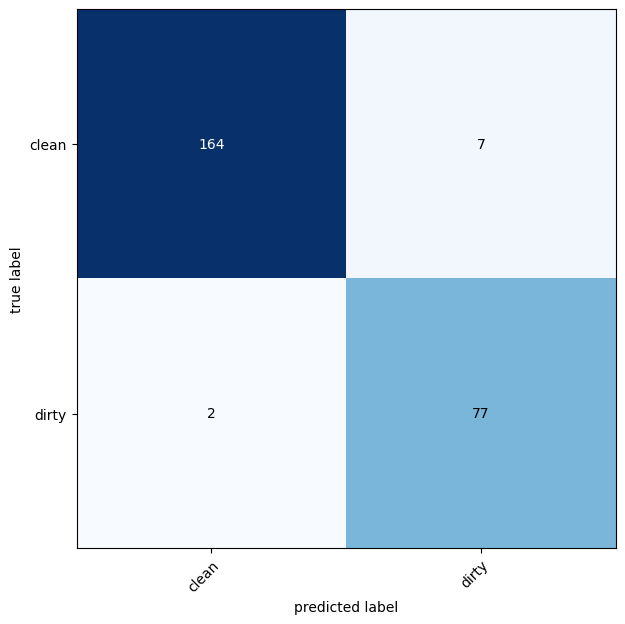

In [ ]:
confmat = ConfusionMatrix(num_classes=len(CLASS_NAMES), task='multiclass')
confmat_tensor = confmat(preds=torch.tensor(pred_values),
                         target=torch.tensor(true_values))

fig, ax = plot_confusion_matrix(
    conf_mat=confmat_tensor.numpy(), 
    class_names=CLASS_NAMES,
    figsize=(10, 7)
);